# Battle of the Neighborhoods: Searching for Maximum Return for Rental Properties in New York City

In [ ]:
import json
import os, types
import pandas as pd
import numpy as np
import seaborn as sns
import requests
from sklearn.cluster import KMeans
# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

In [ ]:
rent_df = pd.read_csv('Zip_ZORI.csv')

In [ ]:
rent_df.shape

(1743, 94)

## 2. Exploratory Analysis

In [ ]:
ny_df = rent_df.copy()
ny_df.rename(columns={'RegionName': 'ZipCode', 'MsaName':'CityState'}, inplace=True)
city = ny_df['CityState'].str.rsplit(",", expand=True)
ny_df['City'] = city[0]
ny_df['State'] = city[1]
ny_df['ZipCode'] = ny_df['ZipCode'].astype('str')
ny_df = ny_df.loc[ny_df['City'] == 'New York']
ny_df

,RegionID,ZipCode,SizeRank,CityState,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,...,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,2019-12,2020-01,2020-02,2020-03,2020-04,2020-05,2020-06,2020-07,2020-08,2020-09,2020-10,2020-11,2020-12,2021-01,2021-02,2021-03,2021-04,2021-05,2021-06,City,State
0,61639,10025,1,"New York, NY",2889.0,2904.0,2919.0,2935.0,2949.0,2964.0,2979.0,2994.0,3008.0,3023.0,3035.0,3048.0,3061.0,3071.0,3081.0,3091.0,3098.0,3105.0,3112.0,3118.0,3124.0,3130.0,3134.0,3138.0,3142.0,3144.0,3146.0,3148.0,3148.0,3148.0,3147.0,3145.0,3143.0,3141.0,3141.0,3141.0,...,3162.0,3167.0,3173.0,3179.0,3186.0,3192.0,3199.0,3205.0,3212.0,3219.0,3226.0,3234.0,3240.0,3246.0,3253.0,3256.0,3260.0,3263.0,3255.0,3247.0,3238.0,3211.0,3183.0,3156.0,3118.0,3080.0,3042.0,3014.0,2986.0,2958.0,2939.0,2919.0,2900.0,2883.0,2865.0,2848.0,2834.0,2820.0,New York,NY
2,61637,10023,3,"New York, NY",3014.0,3024.0,3033.0,3043.0,3052.0,3061.0,3070.0,3079.0,3088.0,3096.0,3103.0,3109.0,3116.0,3121.0,3127.0,3132.0,3138.0,3143.0,3149.0,3155.0,3160.0,3166.0,3171.0,3176.0,3180.0,3181.0,3182.0,3183.0,3181.0,3179.0,3176.0,3174.0,3172.0,3170.0,3170.0,3170.0,...,3185.0,3188.0,3191.0,3194.0,3196.0,3199.0,3204.0,3208.0,3212.0,3217.0,3222.0,3227.0,3232.0,3237.0,3242.0,3247.0,3252.0,3257.0,3250.0,3243.0,3236.0,3212.0,3188.0,3164.0,3128.0,3092.0,3056.0,3027.0,2997.0,2968.0,2946.0,2924.0,2902.0,2881.0,2861.0,2841.0,2824.0,2807.0,New York,NY
6,61616,10002,7,"New York, NY",2699.0,2715.0,2730.0,2746.0,2761.0,2777.0,2792.0,2807.0,2822.0,2838.0,2852.0,2867.0,2882.0,2894.0,2905.0,2917.0,2924.0,2931.0,2938.0,2943.0,2947.0,2952.0,2957.0,2962.0,2967.0,2974.0,2981.0,2987.0,2995.0,3004.0,3012.0,3018.0,3025.0,3032.0,3035.0,3037.0,...,3077.0,3084.0,3091.0,3095.0,3100.0,3105.0,3109.0,3114.0,3119.0,3126.0,3134.0,3142.0,3151.0,3161.0,3170.0,3179.0,3188.0,3197.0,3193.0,3188.0,3183.0,3153.0,3123.0,3092.0,3046.0,2999.0,2953.0,2915.0,2878.0,2840.0,2813.0,2786.0,2759.0,2734.0,2709.0,2685.0,2664.0,2643.0,New York,NY
10,62037,11226,11,"New York, NY",1691.0,1694.0,1696.0,1698.0,1701.0,1704.0,1707.0,1711.0,1715.0,1719.0,1727.0,1736.0,1744.0,1756.0,1768.0,1781.0,1794.0,1807.0,1821.0,1832.0,1843.0,1854.0,1864.0,1874.0,1884.0,1893.0,1902.0,1911.0,1918.0,1925.0,1932.0,1938.0,1944.0,1950.0,1953.0,1956.0,...,2006.0,2013.0,2019.0,2023.0,2028.0,2032.0,2035.0,2038.0,2041.0,2044.0,2046.0,2049.0,2052.0,2055.0,2059.0,2063.0,2068.0,2073.0,2075.0,2077.0,2079.0,2076.0,2072.0,2069.0,2060.0,2050.0,2041.0,2030.0,2019.0,2007.0,1997.0,1987.0,1977.0,1967.0,1957.0,1947.0,1938.0,1928.0,New York,NY
13,61630,10016,16,"New York, NY",3120.0,3132.0,3144.0,3156.0,3168.0,3181.0,3193.0,3205.0,3217.0,3229.0,3243.0,3256.0,3269.0,3281.0,3292.0,3304.0,3313.0,3322.0,3330.0,3336.0,3342.0,3348.0,3350.0,3352.0,3354.0,3353.0,3353.0,3352.0,3350.0,3348.0,3345.0,3343.0,3340.0,3338.0,3337.0,3336.0,...,3368.0,3376.0,3384.0,3392.0,3401.0,3410.0,3418.0,3427.0,3435.0,3442.0,3449.0,3456.0,3463.0,3470.0,3477.0,3481.0,3485.0,3488.0,3478.0,3468.0,3458.0,3424.0,3391.0,3358.0,3307.0,3257.0,3207.0,3167.0,3128.0,3088.0,3060.0,3031.0,3003.0,2977.0,2951.0,2925.0,2903.0,2881.0,New York,NY
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1697,61887,10601,6403,"New York, NY",2125.0,2147.0,2169.0,2192.0,2212.0,2233.0,2253.0,2274.0,2294.0,2314.0,2323.0,2333.0,2342.0,NaN,2346.0,2348.0,2351.0,2354.0,2357.0,2362.0,2366.0,NaN,2379.0,2387.0,

### Crime Data

In [ ]:
nypd_arrest = pd.read_csv('NYPD_Arrests_Data__Historic_.csv')
nypd_arrest.shape

(1516143, 19)

In [ ]:
nypd_shooting = pd.read_csv('NYPD_Shooting_Incident_Data__Historic_.csv')
nypd_shooting.shape

(23568, 19)

In [ ]:
nypd_arrest['ARREST_DATE'] = pd.to_datetime(nypd_arrest['ARREST_DATE'])
nypd_arrest = nypd_arrest.loc[nypd_arrest['ARREST_DATE'] >= '2014-01-01']
nypd_arrest['ARREST_BORO'] = nypd_arrest['ARREST_BORO'].map({'B':'BRONX', 'K':'BROOKLYN', 'M':'MANHATTAN', 'S':'STATEN ISLAND', 'Q':'QUEENS'})
nypd_arrest.drop(columns=['PD_CD', 'PD_DESC', 'KY_CD', 'LAW_CODE', 'ARREST_PRECINCT', 'JURISDICTION_CODE', 'AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'X_COORD_CD', 'Y_COORD_CD'], inplace=True)
nypd_arrest.rename(columns={'ARREST_KEY':'KEY', 'ARREST_DATE': 'DATE', 'ARREST_BORO': 'BORO'}, inplace=True)
nypd_arrest['CRIME'] = 'ARREST'
print(nypd_arrest.shape)
nypd_arrest.head()

(1260742, 9)


,KEY,DATE,OFNS_DESC,LAW_CAT_CD,BORO,Latitude,Longitude,Lon_Lat,CRIME
1,192799737,2019-01-26,SEX CRIMES,F,MANHATTAN,40.800694,-73.941109,POINT (-73.94110928599997 40.800694331000045),ARREST
2,193260691,2019-02-06,NaN,F,MANHATTAN,40.757839,-73.991212,POINT (-73.99121211099998 40.75783900300007),ARREST
3,149117452,2016-01-06,RAPE,F,BROOKLYN,40.648650,-73.950336,POINT (-73.95033556299995 40.648650085000035),ARREST
4,190049060,2018-11-15,RAPE,F,BROOKLYN,40.674583,-73.930222,POINT (-73.93022154099998 40.67458330800008),ARREST
6,189182271,2018-10-24,RAPE,F,MANHATTAN,40.716196,-73.997491,POINT (-73.99749074599998 40.716195914000025),ARREST


In [ ]:
nypd_shooting['OCCUR_DATE'] = pd.to_datetime(nypd_shooting['OCCUR_DATE'])
nypd_shooting = nypd_shooting.loc[nypd_shooting['OCCUR_DATE'] >= '2014-01-01']
nypd_shooting['LAW_CAT_CD'] = 'F'
nypd_shooting.drop(columns=['OCCUR_TIME', 'PRECINCT', 'JURISDICTION_CODE', 'LOCATION_DESC', 'PERP_AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'VIC_RACE', 'X_COORD_CD', 'Y_COORD_CD'], inplace=True)
nypd_shooting.rename(columns={'INCIDENT_KEY':'KEY', 'OCCUR_DATE':'DATE'}, inplace=True)
nypd_shooting['CRIME'] = 'SHOOTING'
nypd_shooting.head()

,KEY,DATE,BORO,STATISTICAL_MURDER_FLAG,Latitude,Longitude,Lon_Lat,LAW_CAT_CD,CRIME
0,201575314,2019-08-23,QUEENS,False,40.697805,-73.808141,POINT (-73.80814071699996 40.697805308000056),F,SHOOTING
1,205748546,2019-11-27,BRONX,False,40.818700,-73.918571,POINT (-73.91857061799993 40.81869973000005),F,SHOOTING
2,193118596,2019-02-02,MANHATTAN,False,40.791916,-73.945480,POINT (-73.94547965999999 40.791916091000076),F,SHOOTING
3,204192600,2019-10-24,STATEN ISLAND,True,40.638064,-74.166108,POINT (-74.16610830199996 40.63806398200006),F,SHOOTING
4,201483468,2019-08-22,BRONX,False,40.854547,-73.913339,POINT (-73.91333944399999 40.85454734900003),F,SHOOTING


In [ ]:
nypd_df = pd.concat([nypd_arrest, nypd_shooting]).reset_index()
nypd_df['Year'] = nypd_df.DATE.dt.to_period('Y')
nypd_df['Month'] = nypd_df.DATE.dt.to_period('M')
nypd_df['STATISTICAL_MURDER_FLAG'].fillna('False', inplace=True)
nypd_df.shape

(1269677, 13)

In [ ]:
!pip install folium
!pip install geopy

In [ ]:
import folium
import geopy.geocoders
from geopy.geocoders import Nominatim

address = 'New York City, NY'

geolocator = Nominatim(user_agent="coursera_capstone_nyc_rentals")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of New York City are 40.7127281, -74.0060152.


In [ ]:
import json
from pandas.io.json import json_normalize

with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)

In [ ]:
neighborhoods_data = newyork_data['features']
neighborhoods_data[0]

{'geometry': {'coordinates': [-73.84720052054902, 40.89470517661],
  'type': 'Point'},
 'geometry_name': 'geom',
 'id': 'nyu_2451_34572.1',
 'properties': {'annoangle': 0.0,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661],
  'borough': 'Bronx',
  'name': 'Wakefield',
  'stacked': 1},
 'type': 'Feature'}

In [ ]:
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
neighborhoods = pd.DataFrame(columns=column_names)

In [ ]:
for data in neighborhoods_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    neighborhoods = neighborhoods.append({'Borough': borough,
                                          'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon}, ignore_index=True)

In [ ]:
neighborhoods

,Borough,Neighborhood,Latitude,Longitude
0,Bronx,Wakefield,40.894705,-73.847201
1,Bronx,Co-op City,40.874294,-73.829939
2,Bronx,Eastchester,40.887556,-73.827806
3,Bronx,Fieldston,40.895437,-73.905643
4,Bronx,Riverdale,40.890834,-73.912585
...,...,...,...,...
301,Manhattan,Hudson Yards,40.756658,-74.000111
302,Queens,Hammels,40.587338,-73.805530
303,Queens,Bayswater,40.611322,-73.765968
304,Queens,Queensbridge,40.756091,-73.945631


#### Lets visualize the locations of all the neighborhoods.

In [ ]:
# create map of New York using latitude and longitude values
map_newyork = folium.Map(location=[latitude, longitude], zoom_start=11)

# add markers to map
for lat, lng, borough, neighborhood in zip(neighborhoods['Latitude'], neighborhoods['Longitude'], neighborhoods['Borough'], neighborhoods['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork)  
    
map_newyork

In [ ]:
ny_zip_hoods = pd.read_csv('nyc_zcta10_to_puma10.csv')
ny_zip_hoods.rename(columns={'nameshort': 'Neighborhood', 'zcta10':'Zip'}, inplace=True)
ny_zip_hoods['Zip'] = ny_zip_hoods['Zip'].astype('str')
ny_zip_hoods.head()

,Zip,Neighborhood
0,10451,"Hunts Point, Longwood & Melrose"
1,10452,"Concourse, Highbridge & Mount Eden"
2,10453,"Morris Heights, Fordham South & Mount Hope"
3,10454,"Hunts Point, Longwood & Melrose"
4,10455,"Hunts Point, Longwood & Melrose"


In [ ]:
ny_boro = pd.read_csv('ny_zip_boro.csv')
# ny_boro.rename(columns={'Neighborhood name': 'Neighborhood', 'Zip codes':'Zip'}, inplace=True)
# temp = ny_boro['Zip'].str.split(',').apply(pd.Series, 1).stack()
# temp.index = temp.index.droplevel(-1)
# temp.name = 'Zip'
# ny_boro.drop(columns='Zip', inplace=True)
# ny_boro = ny_boro.join(temp)
ny_boro['Zip'] = ny_boro['Zip'].astype('str')
ny_boro.head()

,Zip,Borough
0,10001,Manhattan
1,10002,Manhattan
2,10003,Manhattan
3,10004,Manhattan
4,10005,Manhattan


In [ ]:
ny_zip_hoods = ny_zip_hoods.merge(ny_boro, on='Zip', how='left')
ny_zip_hoods = ny_zip_hoods.drop_duplicates().reset_index(drop=True)
ny_zip_hoods

,Zip,Neighborhood,Borough
0,10451,"Hunts Point, Longwood & Melrose",Bronx
1,10452,"Concourse, Highbridge & Mount Eden",Bronx
2,10453,"Morris Heights, Fordham South & Mount Hope",Bronx
3,10454,"Hunts Point, Longwood & Melrose",Bronx
4,10455,"Hunts Point, Longwood & Melrose",Bronx
...,...,...,...
206,10309,"Tottenville, Great Kills & Annadale",Staten
207,10310,"Port Richmond, Stapleton & Mariners Harbor",Staten
208,10311,New Springville & South Beach,Staten
209,10312,"Tottenville, Great Kills & Annadale",Staten


#### Merging the dataframes we find the rental data set only matches 62 out of the 95 zip codes within NYC.

In [ ]:
ny_df1 = ny_df.merge(ny_zip_hoods, left_on='ZipCode', right_on='Zip')
print(ny_df1.shape)
ny_df1.head()

(62, 99)


,RegionID,ZipCode,SizeRank,CityState,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,...,2018-08,2018-09,2018-10,2018-11,2018-12,2019-01,2019-02,2019-03,2019-04,2019-05,2019-06,2019-07,2019-08,2019-09,2019-10,2019-11,2019-12,2020-01,2020-02,2020-03,2020-04,2020-05,2020-06,2020-07,2020-08,2020-09,2020-10,2020-11,2020-12,2021-01,2021-02,2021-03,2021-04,2021-05,2021-06,City,State,Zip,Neighborhood,Borough
0,61639,10025,1,"New York, NY",2889.0,2904.0,2919.0,2935.0,2949.0,2964.0,2979.0,2994.0,3008.0,3023.0,3035.0,3048.0,3061.0,3071.0,3081.0,3091.0,3098.0,3105.0,3112.0,3118.0,3124.0,3130.0,3134.0,3138.0,3142.0,3144.0,3146.0,3148.0,3148.0,3148.0,3147.0,3145.0,3143.0,3141.0,3141.0,3141.0,...,3179.0,3186.0,3192.0,3199.0,3205.0,3212.0,3219.0,3226.0,3234.0,3240.0,3246.0,3253.0,3256.0,3260.0,3263.0,3255.0,3247.0,3238.0,3211.0,3183.0,3156.0,3118.0,3080.0,3042.0,3014.0,2986.0,2958.0,2939.0,2919.0,2900.0,2883.0,2865.0,2848.0,2834.0,2820.0,New York,NY,10025,Upper West Side & West Side,Manhattan
1,61637,10023,3,"New York, NY",3014.0,3024.0,3033.0,3043.0,3052.0,3061.0,3070.0,3079.0,3088.0,3096.0,3103.0,3109.0,3116.0,3121.0,3127.0,3132.0,3138.0,3143.0,3149.0,3155.0,3160.0,3166.0,3171.0,3176.0,3180.0,3181.0,3182.0,3183.0,3181.0,3179.0,3176.0,3174.0,3172.0,3170.0,3170.0,3170.0,...,3194.0,3196.0,3199.0,3204.0,3208.0,3212.0,3217.0,3222.0,3227.0,3232.0,3237.0,3242.0,3247.0,3252.0,3257.0,3250.0,3243.0,3236.0,3212.0,3188.0,3164.0,3128.0,3092.0,3056.0,3027.0,2997.0,2968.0,2946.0,2924.0,2902.0,2881.0,2861.0,2841.0,2824.0,2807.0,New York,NY,10023,Upper West Side & West Side,Manhattan
2,61616,10002,7,"New York, NY",2699.0,2715.0,2730.0,2746.0,2761.0,2777.0,2792.0,2807.0,2822.0,2838.0,2852.0,2867.0,2882.0,2894.0,2905.0,2917.0,2924.0,2931.0,2938.0,2943.0,2947.0,2952.0,2957.0,2962.0,2967.0,2974.0,2981.0,2987.0,2995.0,3004.0,3012.0,3018.0,3025.0,3032.0,3035.0,3037.0,...,3095.0,3100.0,3105.0,3109.0,3114.0,3119.0,3126.0,3134.0,3142.0,3151.0,3161.0,3170.0,3179.0,3188.0,3197.0,3193.0,3188.0,3183.0,3153.0,3123.0,3092.0,3046.0,2999.0,2953.0,2915.0,2878.0,2840.0,2813.0,2786.0,2759.0,2734.0,2709.0,2685.0,2664.0,2643.0,New York,NY,10002,Chinatown & Lower East Side,Manhattan
3,62037,11226,11,"New York, NY",1691.0,1694.0,1696.0,1698.0,1701.0,1704.0,1707.0,1711.0,1715.0,1719.0,1727.0,1736.0,1744.0,1756.0,1768.0,1781.0,1794.0,1807.0,1821.0,1832.0,1843.0,1854.0,1864.0,1874.0,1884.0,1893.0,1902.0,1911.0,1918.0,1925.0,1932.0,1938.0,1944.0,1950.0,1953.0,1956.0,...,2023.0,2028.0,2032.0,2035.0,2038.0,2041.0,2044.0,2046.0,2049.0,2052.0,2055.0,2059.0,2063.0,2068.0,2073.0,2075.0,2077.0,2079.0,2076.0,2072.0,2069.0,2060.0,2050.0,2041.0,2030.0,2019.0,2007.0,1997.0,1987.0,1977.0,1967.0,1957.0,1947.0,1938.0,1928.0,New York,NY,11226,Flatbush & Midwood,Brooklyn
4,61630,10016,16,"New York, NY",3120.0,3132.0,3144.0,3156.0,3168.0,3181.0,3193.0,3205.0,3217.0,3229.0,3243.0,3256.0,3269.0,3281.0,3292.0,3304.0,3313.0,3322.0,3330.0,3336.0,3342.0,3348.0,3350.0,3352.0,3354.0,3353.0,3353.0,3352.0,3350.0,3348.0,3345.0,3343.0,3340.0,3338.0,3337.0,3336.0,...,3392.0,3401.0,3410.0,3418.0,3427.0,3435.0,3442.0,3449.0,3456.0,3463.0,3470.0,3477.0,3481.0,3485.0,3488.0,3478.0,3468.0,3458.0,3424.0,3391.0,3358.0,3307.0,3257.0,3207.0,3167.0,3128.0,3088.0,3060.0,3031.0,3003.0,2977.0,2951.0,2925.0,2903.0,2881.0,New York,NY,10016,"Murray Hill, Gramercy & Stuyvesant Town",Manhattan


#### Let's count the number of crimes in each borough separated by year.

In [ ]:
nypd_grouped = nypd_df[['Year', 'BORO', 'KEY', 'STATISTICAL_MURDER_FLAG']].groupby(['Year', 'BORO']).count().reset_index()
nypd_grouped

,Year,BORO,KEY,STATISTICAL_MURDER_FLAG
0,2014,BRONX,635,635
1,2014,BROOKLYN,763,763
2,2014,MANHATTAN,356,356
3,2014,QUEENS,318,318
4,2014,STATEN ISLAND,70,70
5,2015,BRONX,44763,44763
6,2015,BROOKLYN,54483,54483
7,2015,MANHATTAN,55092,55092
8,2015,QUEENS,38156,38156
9,2015,STATEN ISLAND,6525,6525


#### In order to ensure the numbers are true representations, we should compare them with the populations and population densities of each borough to formulate a crime rate.

In [ ]:
ny_pops = pd.DataFrame(np.array([['MANHATTAN', 1632000, 22.82],
           ['QUEENS', 2299000, 108.1],
           ['BRONX', 1438000, 42.47],
           ['BROOKLYN', 2601000, 69.5],
           ['STATEN ISLAND', 474101, 58.69]]),
            columns=['BORO', 'Population', 'Area'])
ny_pops = ny_pops.apply(pd.to_numeric, errors='ignore')
ny_pops['Pop_dens'] = ny_pops['Population'] / ny_pops['Area']

#### Now we have a better picture of the number of crimes per people per square mile.

In [ ]:
crime_df = nypd_grouped.merge(ny_pops, on='BORO')
crime_df['CrimeDens'] = crime_df['KEY'] / crime_df['Pop_dens']
crime_df['MurderDens'] = crime_df['STATISTICAL_MURDER_FLAG'] / crime_df['Pop_dens']
crime_df.head()

,Year,BORO,KEY,STATISTICAL_MURDER_FLAG,Population,Area,Pop_dens,CrimeDens,MurderDens
0,2014,BRONX,635,635,1438000,42.47,33859.194726,0.018754,0.018754
1,2015,BRONX,44763,44763,1438000,42.47,33859.194726,1.322034,1.322034
2,2016,BRONX,69520,69520,1438000,42.47,33859.194726,2.053209,2.053209
3,2017,BRONX,63127,63127,1438000,42.47,33859.194726,1.864398,1.864398
4,2018,BRONX,55759,55759,1438000,42.47,33859.194726,1.646790,1.646790


#### Surprisingly we see the rank of each Borough by Crimes and Muders remains constant despite what year it is.  We can also discern that despite the differences in population, Manhattan and Staten Island are the safest of the 5 boroughs.  
We will focus in on these boroughs for rental properties per the investment firm's desire to be in the safest areas of NYC.

In [ ]:
crime_df['CrimeRank'] = crime_df.groupby(['Year'])['CrimeDens'].rank(method='dense', ascending=False).astype(int)
crime_df['MurderRank'] = crime_df.groupby(['Year'])['MurderDens'].rank(method='dense', ascending=False).astype(int)
crime_df['Year'] = crime_df['Year'].astype('str')
crime_df.loc[crime_df['Year'] >= '2019']

,Year,BORO,KEY,STATISTICAL_MURDER_FLAG,Population,Area,Pop_dens,CrimeDens,MurderDens,CrimeRank,MurderRank
5,2019,BRONX,49081,49081,1438000,42.47,33859.194726,1.449562,1.449562,3,3
6,2020,BRONX,505,505,1438000,42.47,33859.194726,0.014915,0.014915,2,2
12,2019,BROOKLYN,58660,58660,2601000,69.50,37424.460432,1.567424,1.567424,2,2
13,2020,BROOKLYN,809,809,2601000,69.50,37424.460432,0.021617,0.021617,1,1
19,2019,MANHATTAN,54060,54060,1632000,22.82,71516.213848,0.755912,0.755912,5,5
20,2020,MANHATTAN,274,274,1632000,22.82,71516.213848,0.003831,0.003831,5,5
26,2019,QUEENS,44725,44725,2299000,108.10,21267.345051,2.102989,2.102989,1,1
27,2020,QUEENS,302,302,2299000,108.10,21267.345051,0.014200,0.014200,3,3
33,2019,STATEN ISLAND,9058,9058,474101,58.69,8078.054183,1.121310,1.121310,4,4
34,2020,STATEN ISLAND,52,52,474101,58.69,8078.054183,0.006437,0.006437,4,4


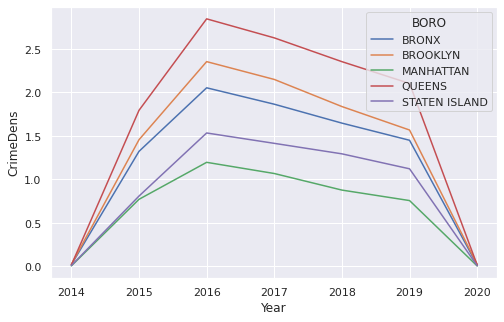

In [ ]:
sns.set(rc={'figure.figsize':(8,5)})
sns.lineplot(data=crime_df, x='Year', y='CrimeDens', hue='BORO')

In [ ]:
# create map of New York using latitude and longitude values
map_newyork_crime = folium.Map(location=[latitude, longitude], zoom_start=11)
nypd_shooting_map = nypd_shooting.copy()
nypd_shooting_map['color'] = nypd_shooting_map['STATISTICAL_MURDER_FLAG'].map({True:'red', False:'yellow'})

# add markers to map
for lat, lng, borough, murder_flag, color in zip(nypd_shooting_map['Latitude'], nypd_shooting_map['Longitude'], nypd_shooting_map['BORO'], nypd_shooting_map['STATISTICAL_MURDER_FLAG'], nypd_shooting_map['color']):
    label = '{}, {}'.format(murder_flag, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=color,
        fill=True,
        fill_opacity=0.7,
        parse_html=False).add_to(map_newyork_crime)  
    
map_newyork_crime

In [ ]:
with open('nyu-geojson.json') as json_data:
    nyc_zip_shapes = json.load(json_data)

In [ ]:
nyc_zip_shapes

{'bbox': [-74.258918762207,
  40.4938278198242,
  -73.6479721069336,
  40.9173812866211],
 'crs': {'properties': {'name': 'urn:ogc:def:crs:EPSG::4326'}, 'type': 'name'},
 'features': [{'geometry': {'coordinates': [[[[-74.00368399999996,
        40.748354999999826],
       [-74.00652899999999, 40.749552999999814],
       [-74.00702299999996, 40.748889999999825],
       [-74.00862099999998, 40.749522999999826],
       [-74.00848699999997, 40.75035699999981],
       [-74.00794499999998, 40.75175999999982],
       [-74.00771299999997, 40.75244399999981],
       [-74.00744899999998, 40.75316499999982],
       [-74.00721799999998, 40.75387299999982],
       [-74.00681499999999, 40.75452199999982],
       [-74.00573299999999, 40.75596999999983],
       [-74.00543699999999, 40.75636399999982],
       [-74.00492699999998, 40.75702299999983],
       [-74.00294199999998, 40.75973099999982],
       [-74.00006699999999, 40.75840299999983],
       [-74.00013799999996, 40.7583069999998],
       [-74.

In [ ]:
# create temp datasets
geo_agg = ny_df1[['Zip', '2021-06', 'Borough', 'Neighborhood']]
nyc_zips = []
# remove ZIP codes not in our rental dataset
for i in range(len(nyc_zip_shapes['features'])):
    if nyc_zip_shapes['features'][i]['properties']['zcta'] in list(geo_agg['Zip'].unique()):
        nyc_zips.append(nyc_zip_shapes['features'][i])
        
# create new JSON object
filtered_json = dict.fromkeys(['type', 'features'])
filtered_json['type'] = 'FeatureCollection'
filtered_json['features'] = nyc_zips

# save JSON as updated file

In [ ]:
ny_rent = ny_df1.iloc[:, 4:].drop(columns=['City', 'State'])
# ny_rent_line = pd.pivot_table(ny_rent, index=['Borough'], aggfunc=np.mean, fill_value=0)
ny_rent = ny_rent.melt(id_vars=["Zip", "Neighborhood", 'Borough'], 
        var_name="Date", 
        value_name="Rent")
ny_rent['Date'] = pd.to_datetime(ny_rent['Date'])
ny_rent

,Zip,Neighborhood,Borough,Date,Rent
0,10025,Upper West Side & West Side,Manhattan,2014-01-01,2889.0
1,10023,Upper West Side & West Side,Manhattan,2014-01-01,3014.0
2,10002,Chinatown & Lower East Side,Manhattan,2014-01-01,2699.0
3,11226,Flatbush & Midwood,Brooklyn,2014-01-01,1691.0
4,10016,"Murray Hill, Gramercy & Stuyvesant Town",Manhattan,2014-01-01,3120.0
...,...,...,...,...,...
5575,10005,"Battery Park City, Greenwich Village & Soho",Manhattan,2021-06-01,3131.0
5576,10280,"Battery Park City, Greenwich Village & Soho",Manhattan,2021-06-01,3297.0
5577,10069,Upper West Side & West Side,Manhattan,2021-06-01,3481.0
5578,10007,"Battery Park City, Greenwich Village & Soho",Manhattan,2021-06-01,4812.0


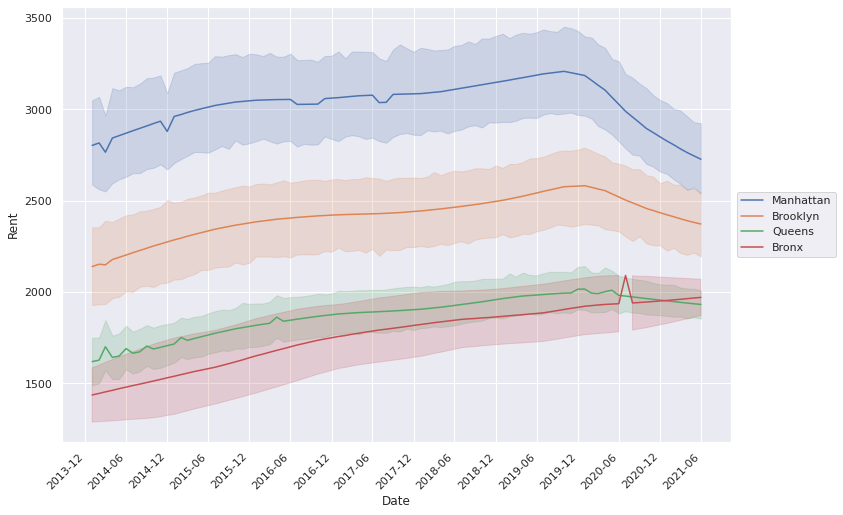

In [ ]:
fig, ax = plt.subplots(figsize=(12,8))
plt.xticks(rotation=45, horizontalalignment='right')
# Major ticks every 6 months.
fmt_half_year = mdates.MonthLocator(interval=6)
ax.xaxis.set_major_locator(fmt_half_year)
# Text in the x axis will be displayed in 'YYYY-mm' format.
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
# Rotates and right aligns the x labels, and moves the bottom of the
# axes up to make room for them.
# fig.autofmt_xdate()
g = sns.lineplot(data=ny_rent, x='Date', y='Rent', hue='Borough')
g.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=1)

#### Here we visualize the lates month's median rent amount with the zip code boundaires and shootings overlaid.  Unfortunately, we also see that rental data is not completely available for all zip codes within NYC.  Therefore, we will only be able to provide the best option to our client with the information we have available.

In [ ]:
# create map of New York using latitude and longitude values
ny_df_map = ny_df1[['Zip', '2021-06', 'Borough', 'Neighborhood']]

map_newyork_rent = folium.Map(location=[latitude, longitude], zoom_start=11)
map_newyork_rent.choropleth(
    geo_data = filtered_json,
    fill_opacity = 0.7,
    line_opacity = 0.2,
    data = ny_df_map,
    key_on = 'feature.properties.zcta',
    columns = ['Zip', '2021-06'],
    fill_color = 'RdYlGn')
# geo_json = folium.GeoJson(filtered_json, popup=folium.GeoJsonPopup(fields=['zcta']))
# geo_json.add_to(map_newyork_rent)
# add markers to map
for lat, lng, borough, murder_flag, color in zip(nypd_shooting_map['Latitude'], nypd_shooting_map['Longitude'], nypd_shooting_map['BORO'], nypd_shooting_map['STATISTICAL_MURDER_FLAG'], nypd_shooting_map['color']):
    label = '{}, {}'.format(murder_flag, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color=color,
        fill=True,
        fill_opacity=0.4,
        parse_html=False).add_to(map_newyork_rent)  
    
map_newyork_rent

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


#### Define Foursquare Credentials

In [ ]:
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    40.87655077879964, 
    -73.91065965862981, 
    400, 
    LIMIT)
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '611542b35f7eb459ebbfbfd3'},
 'response': {'groups': [{'items': [{'reasons': {'count': 0,
       'items': [{'reasonName': 'globalInteractionReason',
         'summary': 'This spot is popular',
         'type': 'general'}]},
      'referralId': 'e-0-4b4429abf964a52037f225e3-0',
      'venue': {'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/food/pizza_',
          'suffix': '.png'},
         'id': '4bf58dd8d48988d1ca941735',
         'name': 'Pizza Place',
         'pluralName': 'Pizza Places',
         'primary': True,
         'shortName': 'Pizza'}],
       'id': '4b4429abf964a52037f225e3',
       'location': {'address': '5198 Broadway',
        'cc': 'US',
        'city': 'New York',
        'country': 'United States',
        'crossStreet': 'at 225th St.',
        'distance': 240,
        'formattedAddress': ['5198 Broadway (at 225th St.)',
         'New York, NY 10463',
         'United States'],
        'labeledLatLngs

In [ ]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [ ]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = pd.json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.postalCode', 'venue.location.lat', 'venue.location.lng']
nearby_venues = nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

,name,categories,postalCode,lat,lng
0,Arturo's,Pizza Place,10463,40.874412,-73.910271
1,Bikram Yoga,Yoga Studio,10463,40.876844,-73.906204
2,Dunkin',Donut Shop,10463,40.877136,-73.906666
3,Astral Fitness & Wellness Center,Gym,10463,40.876705,-73.906372
4,Rite Aid,Pharmacy,10463,40.875467,-73.908906


In [ ]:
def getNearbyVenues(names, latitudes, longitudes, radius=400):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
#         print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat,
            lng,
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name,
            lat, 
            lng, 
            v['venue']['name'],
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue',
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [ ]:
nearby_venues

,name,categories,postalCode,lat,lng
0,Arturo's,Pizza Place,10463,40.874412,-73.910271
1,Bikram Yoga,Yoga Studio,10463,40.876844,-73.906204
2,Dunkin',Donut Shop,10463,40.877136,-73.906666
3,Astral Fitness & Wellness Center,Gym,10463,40.876705,-73.906372
4,Rite Aid,Pharmacy,10463,40.875467,-73.908906
5,Subway,Sandwich Place,10463,40.874667,-73.909586
6,GameStop,Video Game Store,10463,40.874267,-73.909342
7,Baskin-Robbins,Ice Cream Shop,10463,40.877132,-73.906678
8,Parrilla Latina,Steakhouse,10463,40.877473,-73.906073
9,America's Best Contacts & Eyeglasses,Optical Shop,10463,40.874001,-73.909693


In [ ]:
nyc_venues = getNearbyVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude'])

In [ ]:
print(nyc_venues.shape)
nyc_venues.head()

(4972, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Wakefield,40.894705,-73.847201,Lollipops Gelato,40.894123,-73.845892,Dessert Shop
1,Wakefield,40.894705,-73.847201,Rite Aid,40.896649,-73.844846,Pharmacy
2,Wakefield,40.894705,-73.847201,Walgreens,40.896528,-73.844700,Pharmacy
3,Wakefield,40.894705,-73.847201,Pitman Deli,40.896744,-73.844398,Food
4,Wakefield,40.894705,-73.847201,Central Deli,40.896728,-73.844387,Deli / Bodega


In [ ]:
nyc_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Allerton,21,21,21,21,21,21
Annadale,9,9,9,9,9,9
Arden Heights,6,6,6,6,6,6
Arlington,5,5,5,5,5,5
Arrochar,10,10,10,10,10,10
...,...,...,...,...,...,...
Woodhaven,19,19,19,19,19,19
Woodlawn,21,21,21,21,21,21
Woodrow,16,16,16,16,16,16


In [ ]:
print('There are {} uniques categories.'.format(len(nyc_venues['Venue Category'].unique())))

There are 372 uniques categories.


### Analyze each Neighborhood
**Our next objective is to create a dataframe containing the top 10 venues for each neighborhood.**

**1. First, we will perform One Hot Encoding to the venue category for each neighborhood.**

In [ ]:
# one hot encoding
nyc_onehot = pd.get_dummies(nyc_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
nyc_onehot['Neighborhood'] = nyc_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [nyc_onehot.columns[-1]] + list(nyc_onehot.columns[:-1])
nyc_onehot = nyc_onehot[fixed_columns]

nyc_onehot.head()

,Yoga Studio,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Animal Shelter,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bath House,Beach,Beach Bar,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,Bistro,...,Swiss Restaurant,Szechuan Restaurant,Taco Place,Tailor Shop,Taiwanese Restaurant,Tanning Salon,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Tennis Stadium,Tex-Mex Restaurant,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Thrift / Vintage Store,Tibetan Restaurant,Tiki Bar,Toll Plaza,Toy / Game Store,Track,Trail,Train Station,Turkish Restaurant,Used Bookstore,Vape Store,Varenyky restaurant,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Waste Facility,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
nyc_onehot.shape

(4972, 372)

2. Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [ ]:
nyc_grouped = nyc_onehot.groupby('Neighborhood').mean().reset_index()
nyc_grouped

,Neighborhood,Yoga Studio,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Animal Shelter,Antique Shop,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Bath House,Beach,Beach Bar,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bike Trail,...,Swiss Restaurant,Szechuan Restaurant,Taco Place,Tailor Shop,Taiwanese Restaurant,Tanning Salon,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Tennis Stadium,Tex-Mex Restaurant,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Thrift / Vintage Store,Tibetan Restaurant,Tiki Bar,Toll Plaza,Toy / Game Store,Track,Trail,Train Station,Turkish Restaurant,Used Bookstore,Vape Store,Varenyky restaurant,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Waste Facility,Waterfront,Wine Bar,Wine Shop,Wings Joint,Women's Store
0,Allerton,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
1,Annadale,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.111111,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.111111,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
2,Arden Heights,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
3,Arlington,0.0,0.0,0.0,0.0,0.0,0.0,0.200000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
4,Arrochar,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.1,0.0,0.0,0.0,0.0,0.0,0.100000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
294,Woodhaven,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.052632,0.000000,0.105263,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.052632,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0
295,Woodlawn,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.047619,0.0000

In [ ]:
nyc_grouped.shape

(299, 372)

In [ ]:
num_top_venues = 10

for hood in nyc_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = nyc_grouped[nyc_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Allerton----
                  venue  freq
0           Supermarket  0.14
1           Pizza Place  0.14
2         Deli / Bodega  0.10
3        Discount Store  0.10
4   Fried Chicken Joint  0.05
5           Gas Station  0.05
6    Chinese Restaurant  0.05
7   Martial Arts School  0.05
8         Grocery Store  0.05
9  Fast Food Restaurant  0.05


----Annadale----
                   venue  freq
0            Pizza Place  0.22
1           Dance Studio  0.11
2          Deli / Bodega  0.11
3         Cosmetics Shop  0.11
4    American Restaurant  0.11
5                 Bakery  0.11
6             Restaurant  0.11
7          Train Station  0.11
8            Opera House  0.00
9  Outdoors & Recreation  0.00


----Arden Heights----
               venue  freq
0        Coffee Shop  0.17
1         Playground  0.17
2        Pizza Place  0.17
3   Business Service  0.17
4           Pharmacy  0.17
5       Home Service  0.17
6        Yoga Studio  0.00
7             Office  0.00
8  Outdoor Sculpture  0.00

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


                 venue  freq
0                Hotel  0.07
1            Bookstore  0.07
2       Clothing Store  0.07
3                 Park  0.07
4          Yoga Studio  0.03
5     Cuban Restaurant  0.03
6           Steakhouse  0.03
7  Sporting Goods Shop  0.03
8                  Spa  0.03
9           Smoke Shop  0.03


----Midtown South----
                 venue  freq
0    Korean Restaurant  0.23
1  Fried Chicken Joint  0.07
2          Karaoke Bar  0.07
3          Coffee Shop  0.07
4         Dessert Shop  0.03
5                Hotel  0.03
6             Building  0.03
7          Snack Place  0.03
8             Boutique  0.03
9           Shoe Store  0.03


----Midwood----
                   venue  freq
0            Pizza Place  0.29
1                 Bakery  0.14
2         Ice Cream Shop  0.14
3      Convenience Store  0.14
4               Pharmacy  0.14
5            Candy Store  0.14
6            Opera House  0.00
7  Outdoors & Recreation  0.00
8      Outdoor Sculpture  0.00
9      Oth

**3. Let's create a dataframe with the top 10 most common venues**

In [ ]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [ ]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = nyc_grouped['Neighborhood']

for ind in np.arange(nyc_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(nyc_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Allerton,Pizza Place,Supermarket,Deli / Bodega,Discount Store,Mexican Restaurant,Pharmacy,Fast Food Restaurant,Martial Arts School,Fried Chicken Joint,Chinese Restaurant
1,Annadale,Pizza Place,American Restaurant,Deli / Bodega,Dance Studio,Restaurant,Train Station,Bakery,Cosmetics Shop,Event Service,Ethiopian Restaurant
2,Arden Heights,Pharmacy,Business Service,Playground,Pizza Place,Home Service,Coffee Shop,Empanada Restaurant,Entertainment Service,Ethiopian Restaurant,Event Service
3,Arlington,Bus Stop,American Restaurant,Deli / Bodega,Pizza Place,Women's Store,Farmers Market,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space
4,Arrochar,Deli / Bodega,Italian Restaurant,Mediterranean Restaurant,Athletics & Sports,Food Truck,Cosmetics Shop,Pizza Place,Bagel Shop,Ethiopian Restaurant,Event Service


## Cluster the Neighborhoods

In [ ]:
from yellowbrick.cluster import KElbowVisualizer

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:197: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  FutureWarning)


KElbowVisualizer(ax=<matplotlib.axes._subplots.AxesSubplot object at 0x7fc390e11450>,
                 k=None, metric=None, model=None, timings=False)

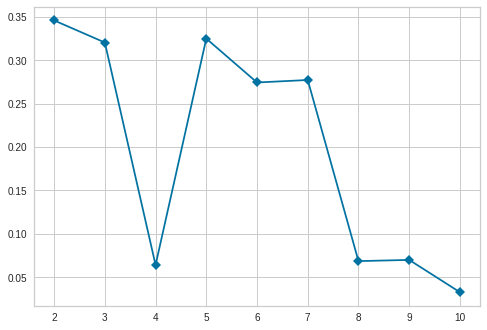

In [ ]:
kclusters = (2,11)

nyc_grouped_clustering = nyc_grouped.drop('Neighborhood', 1)

# run k-means clustering
model = KMeans(random_state=0)
visualizer = KElbowVisualizer(model, k=kclusters, metric='silhouette', timings=False) # random state = 0

visualizer.fit(nyc_grouped_clustering)        # Fit the data to the visualizer
# visualizer.show() 

In [ ]:
# set number of clusters
kclusters = 2

nyc_grouped_clustering = nyc_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(nyc_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 1, 1, 1, 1, 0, 1, 1, 1, 1], dtype=int32)

In [ ]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'ClusterLabels', kmeans.labels_)

nyc_merged = neighborhoods

# merge manhattan_grouped with manhattan_data to add latitude/longitude for each neighborhood
nyc_merged = nyc_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')
nyc_merged = nyc_merged.dropna()
nyc_merged['ClusterLabels'] = nyc_merged['ClusterLabels'].astype('int')
nyc_merged.head() # check the last columns!

,Borough,Neighborhood,Latitude,Longitude,ClusterLabels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Bronx,Wakefield,40.894705,-73.847201,1,Pharmacy,Food,Deli / Bodega,Dessert Shop,Women's Store,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor
1,Bronx,Co-op City,40.874294,-73.829939,1,Bus Station,Salon / Barbershop,Liquor Store,Grocery Store,Market,Park,Restaurant,Basketball Court,Fast Food Restaurant,Chinese Restaurant
2,Bronx,Eastchester,40.887556,-73.827806,1,Deli / Bodega,Caribbean Restaurant,Bus Stop,Bus Station,Diner,Juice Bar,Automotive Shop,Fast Food Restaurant,Donut Shop,Pizza Place
3,Bronx,Fieldston,40.895437,-73.905643,1,River,Plaza,Music Venue,Bus Station,Women's Store,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor
4,Bronx,Riverdale,40.890834,-73.912585,1,Farmers Market,Baseball Field,Moving Target,Plaza,Women's Store,Entertainment Service,Ethiopian Restaurant,Event Service,Event Space,Eye Doctor


In [ ]:
manh_merged = nyc_merged.loc[nyc_merged['Borough'] == 'Manhattan']

In [ ]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_clusters.choropleth(
    geo_data = filtered_json,
    fill_opacity = 0.7,
    line_opacity = 0.2,
    data = ny_df_map,
    key_on = 'feature.properties.zcta',
    columns = ['Zip', '2021-06'],
    fill_color = 'RdYlGn')

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(manh_merged['Latitude'], manh_merged['Longitude'], manh_merged['Neighborhood'], manh_merged['ClusterLabels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
# count the number of unique venues by neighborhood, then match it to the corresponding clustered data and filter to only Manhattan.
unique_venues = nyc_venues.groupby('Neighborhood')['Venue Category'].nunique()
manh_merged1 = manh_merged.merge(unique_venues, on='Neighborhood', how='left')
manh_merged1.rename(columns={'Venue Category': 'Venue_count'}, inplace=True)
manh_merged1.sort_values('Venue_count', ascending=False).head(10)

,Borough,Neighborhood,Latitude,Longitude,ClusterLabels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,Venue_count
16,Manhattan,Murray Hill,40.748303,-73.978332,1,Korean Restaurant,Japanese Restaurant,Coffee Shop,Hotel,Bar,Burger Joint,Bank,Supermarket,Bagel Shop,Salon / Barbershop,32
17,Manhattan,Chelsea,40.744035,-74.003116,1,Hotel,Coffee Shop,Ice Cream Shop,Theater,Seafood Restaurant,Women's Store,Bus Stop,Tapas Restaurant,Beer Bar,Taco Place,31
8,Manhattan,Upper East Side,40.775639,-73.960508,1,Hotel,Pizza Place,Italian Restaurant,Falafel Restaurant,Bar,Sushi Restaurant,Bookstore,Miscellaneous Shop,Burrito Place,Shoe Store,27
1,Manhattan,Chinatown,40.715618,-73.994279,1,Chinese Restaurant,Spa,Sandwich Place,Yoga Studio,Dessert Shop,Spanish Restaurant,Bubble Tea Shop,Salon / Barbershop,Roof Deck,Cocktail Bar,26
36,Manhattan,Tudor City,40.746917,-73.971219,1,Park,Gym,Salad Place,Taco Place,Garden,Sushi Restaurant,Spanish Restaurant,Bridge,Seafood Restaurant,Café,26
35,Manhattan,Turtle Bay,40.752042,-73.967708,1,Karaoke Bar,Wine Bar,Italian Restaurant,Coffee Shop,Duty-free Shop,Grocery Store,Greek Restaurant,Residential Building (Apartment / Condo),Thai Restaurant,Cocktail Bar,26
5,Manhattan,Manhattanville,40.816934,-73.957385,1,Coffee Shop,Seafood Restaurant,Bar,Park,Bike Trail,Climbing Gym,Chinese Restaurant,Latin American Restaurant,Supermarket,Boutique,26
15,Manhattan,Midtown,40.754691,-73.981669,1,Hotel,Bookstore,Park,Clothing Store,Ramen Restaurant,Szechuan Restaurant,Steakhouse,Sporting Goods Shop,Spa,Smoke Shop,26
30,Manhattan,Carnegie Hill,40.782683,-73.953256,1,Pizza Place,Café,Gym,Bookstore,Gym / Fitness Center,Coffee Shop,Restaurant,Nail Salon,Ramen Restaurant,Karaoke Bar,25
12,Manhattan,Upper West Side,40.787658,-73.977059,1,Bar,Bakery,American Restaurant,Italian Restaurant,Bagel Shop,Pub,Theater,Juice Bar,Greek Restaurant,Museum,25


## Finding the best neighborhood in Manhattan
Due to the limitation of no rental data for the second safest area in New York (Staten Island), we will focus on finding the best location in Manhattan.  This will include the lowest rent with the most venues within the closest distance.

Here we can see the all neighborhoods in Manhattan based on the median rent for the most recent month of data.

In [ ]:
manh_rent = ny_rent.loc[(ny_rent['Date'] >= '2021-06') & (ny_rent['Borough'] == 'Manhattan')]
manh_rent

,Zip,Neighborhood,Borough,Date,Rent
5518,10025,Upper West Side & West Side,Manhattan,2021-06-01,2820.0
5519,10023,Upper West Side & West Side,Manhattan,2021-06-01,2807.0
5520,10002,Chinatown & Lower East Side,Manhattan,2021-06-01,2643.0
5522,10016,"Murray Hill, Gramercy & Stuyvesant Town",Manhattan,2021-06-01,2881.0
5525,10029,East Harlem,Manhattan,2021-06-01,2101.0
5526,10009,Chinatown & Lower East Side,Manhattan,2021-06-01,2518.0
5527,10011,"Chelsea, Clinton & Midtown Business District",Manhattan,2021-06-01,2966.0
5528,10128,Upper East Side,Manhattan,2021-06-01,2214.0
5530,10019,"Chelsea, Clinton & Midtown Business District",Manhattan,2021-06-01,2899.0
5531,10003,Chinatown & Lower East Side,Manhattan,2021-06-01,2843.0


Because we can't pick which neighborhoods truly belong to which postal codes, we can use the geopy package to trace our coordinates back to postal codes and merge them back together.

In [ ]:
def get_zipcode(df, geolocator, lat_field, lon_field):
    location = geolocator.reverse((df[lat_field], df[lon_field]))
    return location.raw


geolocator = geopy.Nominatim(user_agent='coursera_capstone_nyc_rentals')

zipcodes = manh_merged1.apply(get_zipcode, axis=1, geolocator=geolocator, lat_field='Latitude', lon_field='Longitude')

In [ ]:
zips = zipcodes.to_json()
zips = pd.read_json(zips)
zips = zips.iloc[4:8, :].apply(pd.Series)
zips_lat = zips.iloc[0, :].apply(pd.Series)
zips_lon = zips.iloc[1, :].apply(pd.Series)
zips_add = zips.iloc[3, :].apply(pd.Series)

In [ ]:

neighbourhoods = zips_lat.merge(zips_lon, left_index=True, right_index=True).merge(zips_add, left_index=True, right_index=True)
neighbourhoods = neighbourhoods.apply(pd.to_numeric, errors='ignore')
neighbourhoods.head()

,0_x,0_y,house_number,road,neighbourhood,suburb,county,city,state,postcode,country,country_code,office,quarter,railway,building,amenity,residential,tourism,historic,shop,highway
0,40.876699,-73.910723,40.0,Van Corlear Place,Marble Hill,Manhattan,New York County,New York,New York,10463,United States,us,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,40.715620,-73.994276,NaN,Canal Street,Chinatown,Manhattan,New York County,New York,New York,10002,United States,us,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,40.851873,-73.937155,730.0,West 183rd Street,Hudson Heights,Manhattan,New York County,New York,New York,10033,United States,us,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,40.867394,-73.921211,604.0,West 207th Street,Inwood,Manhattan,New York County,New York,New York,10034,United States,us,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,40.823709,-73.949762,505.0,West 142nd Street,Hamilton Heights,Manhattan,New York County,New York,New York,10031,United States,us,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
master_rent = neighbourhoods.merge(manh_merged1, left_index=True, right_index=True).merge(manh_rent, left_on='postcode', right_on='Zip') \
.drop(columns=['0_x', '0_y', 'suburb', 'postcode', 'neighbourhood', 'county', 'city', 'state', 'country', 'country_code', 'house_number', 'road', 'Neighborhood_y', 'Borough_y'])

In [ ]:
master_rent.rename(columns={'Borough_x': 'Borough', 'Neighborhood_x': 'Neighborhood'}, inplace=True)

In [ ]:
master_rent = master_rent.sort_values(['Venue_count', 'Rent'], ascending=[False, True])

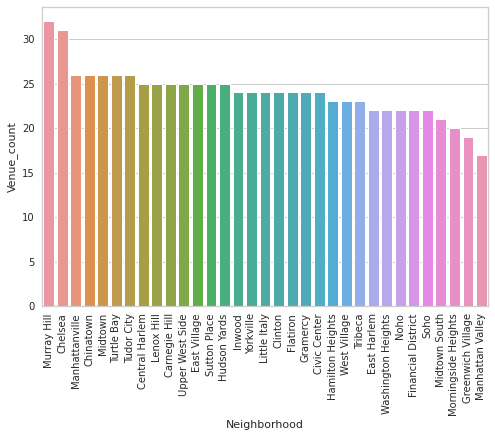

In [ ]:
plt.xticks(rotation=90)
sns.set(rc={'figure.figsize':(5,5)})
sns.barplot(x='Neighborhood', y='Venue_count', data=master_rent)

In [ ]:
manh_shapes = filtered_json
manh_zips = []
for i in range(len(manh_shapes['features'])):
    if manh_shapes['features'][i]['properties']['zcta'] in list(master_rent['Zip'].unique()):
        manh_zips.append(manh_shapes['features'][i])

# create new JSON object
manh_json = dict.fromkeys(['type', 'features'])
manh_json['type'] = 'FeatureCollection'
manh_json['features'] = manh_zips

In [ ]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

# set color scheme
colors_array = cm.rainbow(np.linspace(0, 32, 32))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_clusters.choropleth(
    geo_data = manh_json,
    fill_opacity = 0.7,
    line_opacity = 0.2,
    data = master_rent,
    key_on = 'feature.properties.zcta',
    columns = ['Zip', 'Rent'],
    fill_color = 'RdYlGn')

# add markers to the map
markers_colors = []
for lat, lon, poi in zip(master_rent['Latitude'], master_rent['Longitude'], master_rent['Neighborhood']):
    label = folium.Popup(str(poi), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [ ]:
cluster_1 = manh_merged.loc[manh_merged['ClusterLabels'] == 1, manh_merged.columns[[1] + list(range(5, manh_merged.shape[1]))]]
cluster_1

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
6,Marble Hill,Yoga Studio,Steakhouse,Kids Store,Gym,Optical Shop,Donut Shop,Pharmacy,Deli / Bodega,Pizza Place,Sandwich Place
100,Chinatown,Chinese Restaurant,Spa,Sandwich Place,Yoga Studio,Dessert Shop,Spanish Restaurant,Bubble Tea Shop,Salon / Barbershop,Roof Deck,Cocktail Bar
101,Washington Heights,Café,Park,Wine Shop,Deli / Bodega,Bakery,Pizza Place,Ramen Restaurant,Tapas Restaurant,Liquor Store,Latin American Restaurant
102,Inwood,Wine Bar,Deli / Bodega,Park,Bakery,Mexican Restaurant,Café,Yoga Studio,Farmers Market,Latin American Restaurant,Bistro
103,Hamilton Heights,Coffee Shop,Yoga Studio,Café,Cocktail Bar,Caribbean Restaurant,Mexican Restaurant,Indian Restaurant,Bakery,Burger Joint,Adult Boutique
104,Manhattanville,Coffee Shop,Seafood Restaurant,Bar,Park,Bike Trail,Climbing Gym,Chinese Restaurant,Latin American Restaurant,Supermarket,Boutique
105,Central Harlem,African Restaurant,Bar,Chinese Restaurant,French Restaurant,Café,Gym / Fitness Center,Music Venue,Bagel Shop,Boutique,Caribbean Restaurant
106,East Harlem,Thai Restaurant,Mexican Restaurant,Latin American Restaurant,Donut Shop,Bakery,Cocktail Bar,Spanish Restaurant,Steakhouse,French Restaurant,Seafood Restaurant
107,Upper East Side,Hotel,Pizza Place,Italian Restaurant,Falafel Restaurant,Bar,Sushi Restaurant,Bookstore,Miscellaneous Shop,Burrito Place,Shoe Store
108,Yorkville,Coffee Shop,Deli / Bodega,Café,Italian Restaurant,Gym,Wine Shop,Monument / Landmark,New American Restaurant,Gym / Fitness Center,Bagel Shop


In [ ]:
first = cluster_1.iloc[:,0:2].groupby('1st Most Common Venue').count().sort_values(by='Neighborhood', ascending=False).reset_index()
first.rename(columns={'1st Most Common Venue':'Venue'}, inplace=True)
first.head()

,Venue,Neighborhood
0,Coffee Shop,4
1,Hotel,4
2,Park,3
3,Italian Restaurant,2
4,Theater,2


In [ ]:
second = cluster_1[['Neighborhood','2nd Most Common Venue']].groupby('2nd Most Common Venue').count().sort_values(by='Neighborhood', ascending=False).reset_index()
second.rename(columns={'2nd Most Common Venue':'Venue'}, inplace=True)
second.head()

,Venue,Neighborhood
0,Deli / Bodega,3
1,Steakhouse,3
2,Wine Bar,2
3,Pizza Place,2
4,Café,2


In [ ]:
third = cluster_1[['Neighborhood','3rd Most Common Venue']].groupby('3rd Most Common Venue').count().sort_values(by='Neighborhood', ascending=False).reset_index()
third.rename(columns={'3rd Most Common Venue':'Venue'}, inplace=True)
third.head()

,Venue,Neighborhood
0,Coffee Shop,7
1,Café,3
2,Wine Shop,3
3,Bar,3
4,Italian Restaurant,2


In [ ]:
cluster_1_top3 = pd.concat([first, second, third])
cluster_1_top3 = cluster_1_top3.groupby(by='Venue').sum().sort_values(by='Neighborhood', ascending=False)
cluster_1_top3 = cluster_1_top3.head(15)
cluster_1_top3

,Neighborhood
Venue,
Coffee Shop,13
Park,6
Café,6
Bar,5
Italian Restaurant,4
Wine Shop,4
Hotel,4
Gym,4
Pizza Place,4


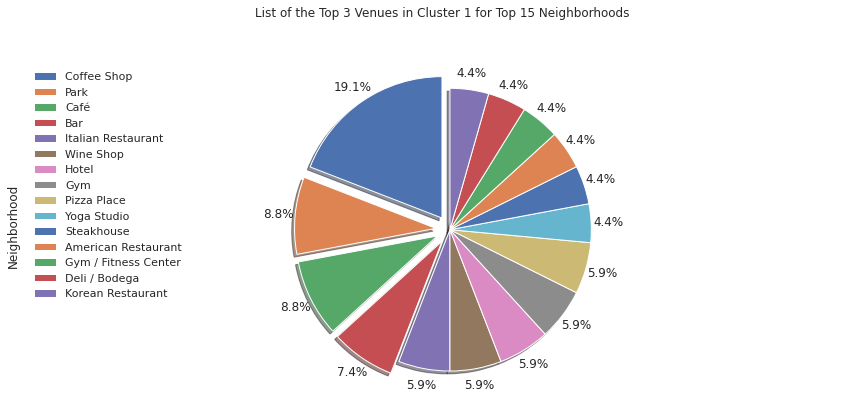

In [ ]:
# ratio for each venue with which to offset each wedge.
explode_list = [0.1, 0.1, 0.1, 0.1]
x = [0] * (len(cluster_1_top3['Neighborhood']) - 4)
explode_list.extend(x)

cluster_1_top3['Neighborhood'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=True,       
                            labels=None,         # turn off labels on pie chart
                            pctdistance=1.12,    # the ratio between the center of each pie slice and the start of the text generated by autopct 
                            explode=explode_list # 'explode' lowest 3 continents
                            )

# scale the title up by 12% to match pctdistance
plt.title('List of the Top 3 Venues in Cluster 1 for Top 15 Neighborhoods', y=1.12, loc='center') 
plt.axis('equal') 

# add legend
plt.legend(labels=cluster_1_top3.index, loc='upper left') 
plt.show()

We can see that despite having a lower count of venues, Inwood appears to be the best combination of venues and low rent within Manhattan!

In [ ]:
master_rent['rent_per_venue'] = master_rent['Rent'] / master_rent['Venue_count']
master_rent_short = master_rent[['Neighborhood', '1st Most Common Venue', '2nd Most Common Venue', '3rd Most Common Venue', 'Venue_count', 'Rent', 'rent_per_venue']].sort_values('rent_per_venue')
master_rent_short.head(10)

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Venue_count,Rent,rent_per_venue
2,Inwood,Wine Bar,Deli / Bodega,Park,24,1867.0,77.791667
6,Central Harlem,African Restaurant,Bar,Chinese Restaurant,25,2087.0,83.480000
8,Yorkville,Coffee Shop,Deli / Bodega,Café,24,2044.0,85.166667
4,Manhattanville,Coffee Shop,Seafood Restaurant,Bar,26,2254.0,86.692308
9,Lenox Hill,Gym,Taco Place,Thai Restaurant,25,2171.0,86.840000
27,Carnegie Hill,Pizza Place,Café,Gym,25,2214.0,88.560000
13,Murray Hill,Korean Restaurant,Japanese Restaurant,Coffee Shop,32,2881.0,90.031250
3,Hamilton Heights,Coffee Shop,Yoga Studio,Café,23,2183.0,94.913043
7,East Harlem,Thai Restaurant,Mexican Restaurant,Latin American Restaurant,22,2101.0,95.500000
15,Chelsea,Hotel,Coffee Shop,Ice Cream Shop,31,2966.0,95.677419
